In [1]:
import pathlib 
import matplotlib.pyplot as plt
import seaborn as sns
sns.set()
import numpy as np
import pandas as pd
import sleepPy.preprocessing as prep
import sleepPy.plots as plot
import actiPy.actogram_plot as aplot

In [2]:
def quickplot_h(data):
    data.resample("H").mean().plot(subplots=True,
                                  figsize=(10,10))
def quickplot(data):
    data.plot(subplots=True,
               figsize=(10,10))

In [3]:
col_names = ["Chamber", "PIR1", "PIR2", "PIR3", "PIR4", "PIR5", "PIR6", "LDR"]

In [4]:
pir_files_dir = pathlib.Path('/Users/angusfisk/Documents/01_PhD_files/09_pirdata')

exp_filesdir = pir_files_dir / "03_experiment_files"

In [5]:
# read df's in
exp = sorted(exp_filesdir.glob("*5*"))

file = exp[1]
df = pd.read_csv(file, 
                 index_col=[0],
                 parse_dates=True)

In [6]:
df.columns=col_names
df.drop(col_names[0], axis=1, inplace=True)
df.sort_index(inplace=True)

In [7]:
df.head()

,PIR1,PIR2,PIR3,PIR4,PIR5,PIR6,LDR
2016-09-19 14:34:00.722,0.0,0.0,0.0,0.0,0.0,0.0,291.0
2016-09-19 14:34:10.720,0.0,0.0,0.0,0.0,0.0,0.0,294.0
2016-09-19 14:34:20.714,0.0,0.0,0.0,0.0,0.0,0.0,295.0
2016-09-19 14:34:50.940,0.0,0.0,0.0,0.0,0.0,0.0,294.0
2016-09-19 14:35:00.935,0.0,0.0,0.0,0.0,0.0,0.0,294.0


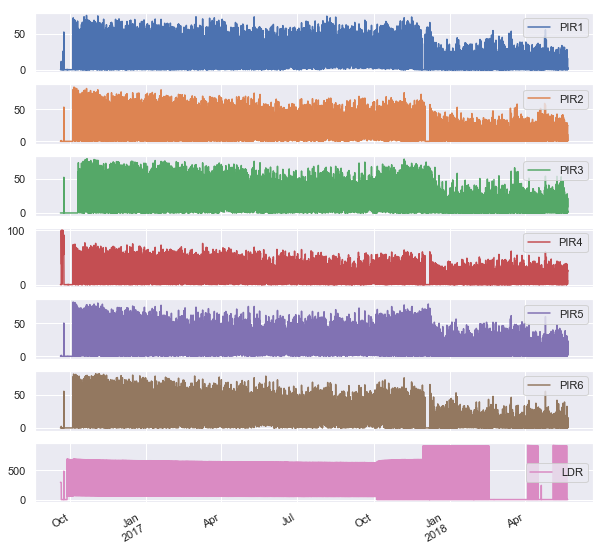

In [8]:
quickplot_h(df)

In [9]:
# Separate into just the ageing part 
start_date = "2016-10-04"
finish_date = '2017-10-04'
ageing_data = df.loc[start_date:finish_date].copy()

In [10]:
ageing_data.head()


,PIR1,PIR2,PIR3,PIR4,PIR5,PIR6,LDR
2016-10-04 00:00:04.123,0.0,0.0,0.0,0.0,0.0,0.0,60.0
2016-10-04 00:00:14.117,0.0,0.0,0.0,0.0,0.0,0.0,60.0
2016-10-04 00:00:24.111,0.0,0.0,0.0,0.0,0.0,0.0,59.0
2016-10-04 00:00:34.105,0.0,0.0,0.0,0.0,0.0,0.0,59.0
2016-10-04 00:00:44.099,0.0,0.0,0.0,0.0,0.0,0.0,61.0


In [11]:
ageing_data.tail()

,PIR1,PIR2,PIR3,PIR4,PIR5,PIR6,LDR
2017-10-04 23:59:20.009,44.0,53.0,37.0,0.0,61.0,54.0,0.0
2017-10-04 23:59:30.003,41.0,64.0,71.0,0.0,50.0,5.0,0.0
2017-10-04 23:59:39.997,64.0,62.0,73.0,0.0,0.0,0.0,0.0
2017-10-04 23:59:49.990,29.0,23.0,30.0,0.0,0.0,0.0,0.0
2017-10-04 23:59:59.984,46.0,60.0,51.0,0.0,19.0,16.0,0.0


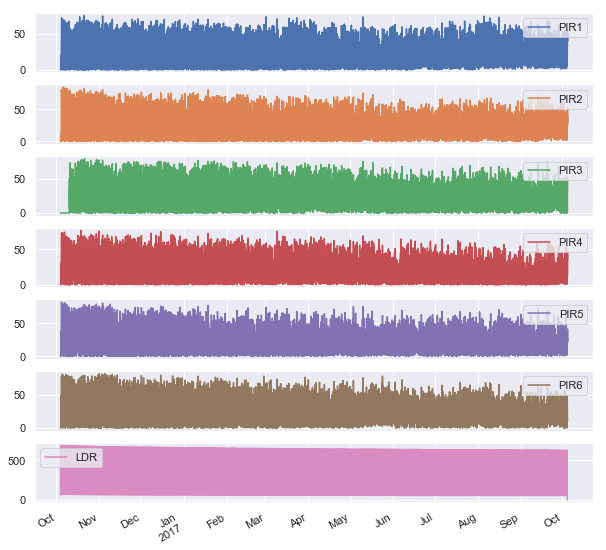

In [12]:
# check the data is all there and looks good 
quickplot_h(ageing_data)

In [13]:

aplot._actogram_plot_from_df(ageing_data, 1, drop_level=False, fname=file, figsize=(100, 200))

All data present and correct. Light cycles are fine


In [14]:
# save the csv 

In [15]:
save_dir = pathlib.Path("/Users/angusfisk/Documents/01_PhD_files/"
                        "01_projects/01_thesisdata/04_ageing/01_datafiles/01_activity")

save_name = save_dir / "dlan.csv"

ageing_data.to_csv(save_name)